In [1]:
using Pkg
Pkg.activate("..")

 Activating environment at `/Extension_HDD1/GitHub-Projects/RnaExplorer/Project.toml`


In [2]:
using CSV, DataFrames, LinearAlgebra
using Statistics, StatsBase, MultivariateStats
using UMAP, Distances, RCall
using Plots, Plots.PlotMeasures
using StatsPlots:violin, violin!
#pyplot()

In [44]:
using StatsPlots:violin, violin!

In [3]:
R"library(Seurat)"

RObject{StrSxp}
[1] "Seurat"    "stats"     "graphics"  "grDevices" "utils"     "datasets" 
[7] "methods"   "base"     


In [4]:
using PyCall
@pyimport magic 
@pyimport pandas

### Load Data

In [6]:
data_dir = "/home/coco/ICOS_Backup/data/GSE131847_RAW/"
readdir(data_dir)

25-element Array{String,1}:
 "GSM3822179_Naive_cell-gene_UMI_table.tsv"
 "GSM3822180_D3_cell-gene_UMI_table.tsv"
 "GSM3822181_D4_cell-gene_UMI_table.tsv"
 "GSM3822182_D4_TRM_cell-gene_UMI_table.tsv"
 "GSM3822183_D5_cell-gene_UMI_table.tsv"
 "GSM3822184_D6_cell-gene_UMI_table.tsv"
 "GSM3822185_D7_cell-gene_UMI_table.tsv"
 "GSM3822186_D7_2_cell-gene_UMI_table.tsv"
 "GSM3822187_D7_TRM_cell-gene_UMI_table.tsv"
 "GSM3822188_D10_cell-gene_UMI_table.tsv"
 "GSM3822189_D10_2_cell-gene_UMI_table.tsv"
 "GSM3822190_D10_TRM_cell-gene_UMI_table.tsv"
 "GSM3822191_D14_cell-gene_UMI_table.tsv"
 "GSM3822192_D14_2_cell-gene_UMI_table.tsv"
 "GSM3822193_D14_TRM_cell-gene_UMI_table.tsv"
 "GSM3822194_D21_cell-gene_UMI_table.tsv"
 "GSM3822195_D21_2_cell-gene_UMI_table.tsv"
 "GSM3822196_D21_TRM_cell-gene_UMI_table.tsv"
 "GSM3822197_D32_cell-gene_UMI_table.tsv"
 "GSM3822198_D32_TRM_cell-gene_UMI_table.tsv"
 "GSM3822199_D32_TRM_2_cell-gene_UMI_table.tsv"
 "GSM3822200_D60_cell-gene_UMI_table.tsv"
 "GSM3822201_D60

In [7]:
#Cell - Gene tbl
cell_type_label = Vector{String}()
raw_umi_cnt = DataFrame()

for umi_table in readdir(data_dir)
    name = match(r"GSM\d*_(.*)_cell-gene", umi_table)[1]
    ct_tbl = CSV.read(joinpath(data_dir, umi_table), DataFrame)
    #push cell label
    cell_number = size(ct_tbl, 1)
    for i = 1:cell_number
        push!(cell_type_label, name)
    end
    #append table
    raw_umi_cnt = vcat(raw_umi_cnt, ct_tbl)
end

In [13]:
#work with the data matrix. However keep track of the row and col names before and after filter
#select!(raw_umi_cnt, Not(:cell_id))
raw_umi_mat = select(raw_umi_cnt, Not(:cell_id)) |> Matrix

45215×9941 Array{Int64,2}:
 0  0  1  0  0  0  0  0  0  0  0  0  1  …  21  3  0   3  2  0   5  0  0  0  0
 1  1  1  0  1  0  0  0  1  0  0  0  0     16  0  0   8  2  0   5  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  0      9  0  0  10  3  0  13  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  0      8  0  0   7  1  0   2  0  0  0  1
 0  0  0  0  0  0  0  0  0  0  0  0  0     22  3  0   6  0  0   7  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  0  …   7  1  0   0  0  0   1  0  0  1  0
 1  0  0  1  0  0  0  0  0  0  2  1  0     18  2  0   3  0  0   9  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  0     26  0  1   8  2  0  11  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  0     13  0  0   2  0  0   6  0  0  1  0
 0  0  0  0  0  0  0  0  0  0  0  0  0     15  1  0   5  2  0   5  0  0  0  0
 0  0  0  0  0  0  0  1  0  0  0  0  1  …  10  4  0   7  0  0   8  0  0  0  0
 0  0  0  0  0  0  1  0  0  0  0  0  0     15  1  0   3  1  0  10  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  

### Seurat Extract High Variance Genes (HVGs) List

Prepare matrix

In [44]:
#barcode
open("barcodes.tsv", "w") do write_barcode
    for (bc, ct) in zip(raw_umi_cnt["cell_id"], cell_type_label)
        write(write_barcode, "$bc-$ct\n")
    end
end

#gene names
open("genes.tsv", "w") do write_genes
    for (i, gn) in enumerate(names(raw_umi_cnt)[2:end])
        write(write_genes, "fakename$i\t$gn")
        write(write_genes, "\n")
    end
end

#matrix
open("matrix.mtx", "w") do write_matrix
    write(write_matrix, "%%MatrixMarket matrix coordinate real general\n%\n")
    
    #gene - cell mtx
    mat = Matrix(raw_umi_cnt[2:end])' |> copy
    n, m = size(mat)
    
    I, J, V = Int[], Int[], Int[]
    nzvals = 0
    
    for j = 1:m, i = n:-1:1
        v = mat[i, j]
        if v != 0
            nzvals += 1
            push!(I, i)
            push!(J, j)
            push!(V, v)
        end
    end
    
    write(write_matrix, "$n\t$m\t$nzvals\n")
    for i = 1:nzvals
        write(write_matrix, "$(I[i])\t$(J[i])\t$(V[i])\t")
    end
end

,cell_id,Mrpl15,Lypla1,Tcea1,Atp6v1h,Rb1cc1,X4732440D04Rik,Pcmtd1
,String,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,CAGTCCTTCCAAGTAC-1,0,0,1,0,0,0,0
2,TAAGTGCTCTCTGAGA-1,1,1,1,0,1,0,0
3,CGCTTCATCTTACCTA-1,0,0,0,0,0,0,0
4,TCTTCGGAGTTTAGGA-1,0,0,0,0,0,0,0
5,AATCCAGCATAGACTC-1,0,0,0,0,0,0,0
6,CTTAGGAGTGTTAAGA-1,0,0,0,0,0,0,0
7,TGACTAGTCCTTTCGG-1,1,0,0,1,0,0,0
8,GACACGCGTACCGTAT-1,0,0,0,0,0,0,0
9,CTAATGGCACTGTGTA-1,0,0,0,0,0,0,0


Seurat process

In [11]:
function seurat_extract_hvg_list(data_dir, min_cells=3, min_features=200, mt_gene_pattern="^mt.", scale_factor=10_000, hvg_length=3000)
    R"""
    proj.data <- Read10X(data.dir = $data_dir)
    proj <- CreateSeuratObject(counts = proj.data, project = "proj_full", min.cells = $min_cells, min.features = $min_features)
    
    proj[["percent.mt"]] <- PercentageFeatureSet(proj, pattern = $mt_gene_pattern)
    proj <- NormalizeData(proj, normalization.method = "LogNormalize", scale.factor = $scale_factor)
    
    proj <- FindVariableFeatures(proj, selection.method = "vst", nfeatures = $hvg_length)
    hvg_list = VariableFeatures(proj)
    """
    
    @rget hvg_list
end

seurat_extract_hvg_list (generic function with 6 methods)

In [12]:
hvg_list = seurat_extract_hvg_list("combine_trm_sc/")

┌ Warning: RCall.jl: Warning: Feature names cannot have underscores ('_'), replacing with dashes ('-')
└ @ RCall /home/coco/.julia/packages/RCall/Qzssx/src/io.jl:160
┌ Warning: RCall.jl: Performing log-normalization
│ 0%   10   20   30   40   50   60   70   80   90   100%
│ [----|----|----|----|----|----|----|----|----|----|
│ **************************************************|
└ @ RCall /home/coco/.julia/packages/RCall/Qzssx/src/io.jl:160
┌ Warning: RCall.jl: Calculating gene variances
│ 0%   10   20   30   40   50   60   70   80   90   100%
│ [----|----|----|----|----|----|----|----|----|----|
│ **************************************************|
│ Calculating feature variances of standardized and clipped values
│ 0%   10   20   30   40   50   60   70   80   90   100%
│ [----|----|----|----|----|----|----|----|----|----|
│ **************************************************|
└ @ RCall /home/coco/.julia/packages/RCall/Qzssx/src/io.jl:160


3000-element Array{String,1}:
 "Cd74"
 "Cxcl10"
 "Mt2"
 "Mt3"
 "Mt1"
 "Tyrobp"
 "Batf3"
 "Loxl2"
 "Tmem267"
 "Fcer1g"
 "Dqx1"
 "Ifitm1"
 "Tnfrsf4"
 ⋮
 "Gm20604"
 "Zfp422"
 "Psmf1"
 "Nthl1"
 "Zzz3"
 "Amd1"
 "Btla"
 "Gphn"
 "Wfikkn2"
 "Tex10"
 "Phykpl"
 "Emid1"

### Data Filter and Normalization

In [14]:
function filter_and_norm_data(raw_umi_mat, low_cell_depth=1000, low_gene_number=200, high_gene_number=5000, mt_ratio=0.05, low_gene_converage=10, scale_to=10_000)
    #cell depth
    per_cell_seq_depth = sum(raw_umi_mat, dims=2) |> vec
    #histogram(per_cell_seq_depth)

    #detected genes per cell
    per_cell_number_detected_genes = sum(raw_umi_mat .!= 0, dims = 2) |> vec
    #histogram(per_cell_number_detected_genes)
    
    #remove low coverage cells (1000)
    mask_low_coverage_cells = per_cell_seq_depth .>= low_cell_depth 

    #500 < expressed genes by cell < 5000
    mask_high_gene_number_cells = vec(per_cell_number_detected_genes .<= high_gene_number)
    mask_low_gene_number_cells = vec(per_cell_number_detected_genes .>= low_gene_number)

    #mitochondrial genes >= 5%
    mt_genes = [startswith(gn, "mt") for gn in names(raw_umi_cnt)[2:end]]
    mask_mt_high_cells = vec((sum(raw_umi_mat[:, mt_genes], dims = 2) ./ per_cell_seq_depth) .<= mt_ratio)

    #filter genes detect <= 10 cells
    mask_low_coverage_genes = vec([sum(raw_umi_mat[:, i] .!= 0) > low_gene_converage for i = 1:size(raw_umi_mat, 2)]);

    #merge filters
    cell_filter = mask_low_coverage_cells .& mask_low_gene_number_cells .& mask_high_gene_number_cells .& mask_mt_high_cells
    gene_filter = mask_low_coverage_genes

    println(sum(cell_filter), " cells and ", sum(gene_filter), " genes pass filter")
    
    umi_norm_mat = raw_umi_mat[cell_filter, gene_filter] |> copy

    #scale to 10_000 depth per cell
    per_cell_seq_depth = sum(umi_norm_mat, dims=2) |> vec
    size_factor = scale_to ./ per_cell_seq_depth
    umi_norm_mat = umi_norm_mat .* size_factor
    umi_norm_mat, cell_filter, gene_filter
end

filter_and_norm_data (generic function with 7 methods)

In [15]:
umi_norm_mat, cell_filter, gene_filter = filter_and_norm_data(raw_umi_mat)

39941 cells and 9941 genes pass filter


([0.0 0.0 … 0.0 0.0; 3.537318712415989 3.537318712415989 … 0.0 0.0; … ; 0.0 3.254149040026033 … 3.254149040026033 0.0; 0.0 0.0 … 5.694760820045558 0.0], Bool[1, 1, 1, 1, 1, 1, 1, 0, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1], Bool[1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [29]:
#cell depth
per_cell_seq_depth = sum(raw_umi_mat, dims=2) |> vec
#histogram(per_cell_seq_depth)

#detected genes per cell
per_cell_number_detected_genes = sum(raw_umi_mat .!= 0, dims = 2) |> vec
#histogram(per_cell_number_detected_genes)

45215-element Array{Int64,1}:
  945
  891
  981
  744
  890
  680
  996
  717
  716
  856
  816
  791
  713
    ⋮
 1047
 1163
 1227
  962
 1351
 1076
 1252
 1003
 1088
 2220
 1103
 1164

In [16]:
filtered_genes = names(raw_umi_cnt)[2:end][gene_filter]
filtered_cell_label = cell_type_label[cell_filter]
cell_types = unique(filtered_cell_label)

25-element Array{String,1}:
 "Naive"
 "D3"
 "D4"
 "D4_TRM"
 "D5"
 "D6"
 "D7"
 "D7_2"
 "D7_TRM"
 "D10"
 "D10_2"
 "D10_TRM"
 "D14"
 "D14_2"
 "D14_TRM"
 "D21"
 "D21_2"
 "D21_TRM"
 "D32"
 "D32_TRM"
 "D32_TRM_2"
 "D60"
 "D60_TRM"
 "D90"
 "D90_TRM"

### Impute Gene Expression by MAGIC

In [17]:
function magic_impute_expression(mat, target_genes)
    umi_norm_sqrt_mat = sqrt.(umi_norm_mat)
    n, m = size(umi_norm_sqrt_mat)
    k = length(target_genes)
    
    imputed = zeros(Float64, n, k)
    
    #magic impute
    py_ctm = Dict(filtered_genes[i] => ge for (i, ge) in enumerate(eachcol(umi_norm_sqrt_mat))) |> pandas.DataFrame
    magic_op = magic.MAGIC()
    py_ctm_magic = magic_op.fit_transform(py_ctm, genes = target_genes)
    
    for (i, gn) in enumerate(target_genes)
        imputed[:, i] .= [v^2 for v in py_ctm_magic[gn]]
    end
    imputed
end

magic_impute_expression (generic function with 1 method)

In [ ]:
srrm2_magic_impute = magic_impute_expression(umi_norm_mat, ["Srrm2"])

### UMAP Visualization

In [18]:
umi_norm_log_mat = log.(umi_norm_mat .+ 1)

39941×9941 Array{Float64,2}:
 0.0      0.0      1.60149  0.0      0.0      …  0.0  0.0  0.0       0.0
 1.51234  1.51234  1.51234  0.0      1.51234     0.0  0.0  0.0       0.0
 0.0      0.0      0.0      0.0      0.0         0.0  0.0  0.0       0.0
 0.0      0.0      0.0      0.0      0.0         0.0  0.0  0.0       1.70852
 0.0      0.0      0.0      0.0      0.0         0.0  0.0  0.0       0.0
 0.0      0.0      0.0      0.0      0.0      …  0.0  0.0  1.96606   0.0
 1.35802  0.0      0.0      1.35802  0.0         0.0  0.0  0.0       0.0
 0.0      0.0      0.0      0.0      0.0         0.0  0.0  1.96448   0.0
 0.0      0.0      0.0      0.0      0.0         0.0  0.0  0.0       0.0
 0.0      0.0      0.0      0.0      0.0         0.0  0.0  0.0       0.0
 0.0      0.0      0.0      0.0      0.0      …  0.0  0.0  0.0       0.0
 0.0      0.0      0.0      0.0      0.0         0.0  0.0  0.0       0.0
 1.19277  0.0      0.0      0.0      0.0         0.0  0.0  0.0       0.0
 ⋮                

Keep HVGs

In [20]:
#High Variable genes
hvg_index = [i for (i, gn) in enumerate(filtered_genes) if gn ∈ hvg_list]

hvg_umi_norm_mat = umi_norm_log_mat[:, hvg_index]
hvg_umi_norm_zmat = standardize(ZScoreTransform, hvg_umi_norm_mat, dims = 1)

39941×2999 Array{Float64,2}:
 -0.619978  -0.379475  -0.529118  …   0.822558   1.38404   -0.561934
  1.80406   -0.379475  -0.529118      0.720284  -0.771513  -0.561934
 -0.619978  -0.379475  -0.529118      1.30541   -0.771513  -0.561934
 -0.619978  -0.379475  -0.529118      0.330091  -0.771513  -0.561934
 -0.619978  -0.379475  -0.529118      0.243344  -0.771513  -0.561934
 -0.619978  -0.379475  -0.529118  …  -1.42331   -0.771513  -0.561934
  1.55672   -0.379475   2.92161       0.54049   -0.771513  -0.561934
 -0.619978  -0.379475  -0.529118      0.592773  -0.771513  -0.561934
 -0.619978  -0.379475  -0.529118      0.23401    1.40209   -0.561934
 -0.619978   3.65651   -0.529118      0.96303   -0.771513  -0.561934
 -0.619978  -0.379475  -0.529118  …   0.955373   1.54166   -0.561934
 -0.619978  -0.379475  -0.529118      0.455493  -0.771513  -0.561934
  1.29185   -0.379475  -0.529118      1.61825    0.833924   1.50783
  ⋮                               ⋱                        
 -0.619978  -0.

UMAP

In [21]:
M = fit(PCA, hvg_umi_norm_zmat'; maxoutdim=50)

PCA(indim = 2999, outdim = 50, principalratio = 0.1195780821121119)

In [22]:
hvg_umi_pca_transform = MultivariateStats.transform(M, hvg_umi_norm_zmat')

50×39941 Array{Float64,2}:
  4.48937     6.90618     6.55225     …    0.849174   7.22397    6.97972
 -7.2353     -4.5586     -4.74159         -4.43129   -4.04827   -1.9613
  4.8409      5.59182     4.05496        -11.2137    -5.63652   -4.75538
  6.47672     7.12859     6.88968         -1.93768    3.99338    2.17974
 -1.79796    -6.42697    -6.02482          0.527577   0.565292   0.480281
  1.77426     0.565271   -0.0679175   …   -1.69899   -2.50077   -2.33022
 -1.66974    -1.71418    -0.315997         3.71646    3.91851    2.70077
 -0.955652    1.89185     1.27126          3.73436    1.37934    0.456092
 -1.36435    -3.57037    -1.80261          0.92814    2.35527   -0.243471
 -2.36366    -0.10416    -0.530627         0.213829   0.427448   1.57885
 -2.7432     -2.57144    -2.65058     …    1.15208   -0.118714   0.340365
 -0.0191806  -0.935002   -2.30538          0.23253   -2.23549   -2.67669
  2.13642    -0.866183   -0.540253         2.94261    0.200646  -1.57094
  ⋮                  

In [46]:
n_neighbors, min_dist = 30, 0.1
res_jl = umap(hvg_umi_pca_transform[1:25, :]; n_neighbors=n_neighbors, min_dist=min_dist, metric=Jaccard(), n_epochs=200)

2×39941 Array{Float64,2}:
  -3.88045   -4.37089   -4.36107   -4.75059  …  -6.7981  -7.2044   -7.22082
 -12.9979   -13.1595   -12.9852   -12.3864       4.8444   5.74537   6.15346

In [50]:
figure = plot(title="UMAP, n_neighbor=$n_neighbors, min_dist=$min_dist", legend=:outerright, size=(1300, 1000))
scatter!(
    res_jl[1,:], 
    res_jl[2,:], 
    markerstrokewidth=0, markersize=1.5, #markerstroke
    zcolor=log.(srrm2_magic_impute * 100 .+ 1), mc=:balance,
    clim = (0, 6.8)
    #marker=occursin("TRM", ct) ? :diamond : :circle,
)
figure
#savefig("all_umap_Icos_z.pdf")

┌ Warning: seriestype violin has been moved to StatsPlots.  To use: `Pkg.add("StatsPlots"); using StatsPlots`
└ @ Plots /home/coco/.julia/packages/Plots/5ItHH/src/args.jl:1178
┌ Warning: seriestype violin has been moved to StatsPlots.  To use: `Pkg.add("StatsPlots"); using StatsPlots`
└ @ Plots /home/coco/.julia/packages/Plots/5ItHH/src/args.jl:1178


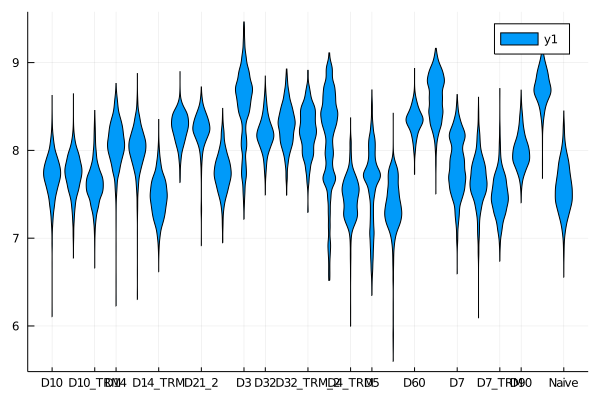

In [49]:
violin(filtered_cell_label, log2.(srrm2_magic_impute * 100 .+ 1))

In [33]:
figure = plot(title="UMAP, n_neighbor=$n_neighbors, min_dist=$min_dist", legend=:outerright, size=(1100,1100))
for ct in cell_types
    #merge repliates of samples
    occursin("_2", ct) && continue
    index_range = (filtered_cell_label .== ct) .| (filtered_cell_label .== "$(ct)_2")

    scatter!(
        res_jl[1,index_range], 
        res_jl[2,index_range], 
        label=ct, markerstrokewidth=0, 
        markersize=1.5,
        marker=occursin("TRM", ct) ? :diamond : :circle,
    )
end
figure
#savefig("all_umap_complete_cell_type_lable.pdf")

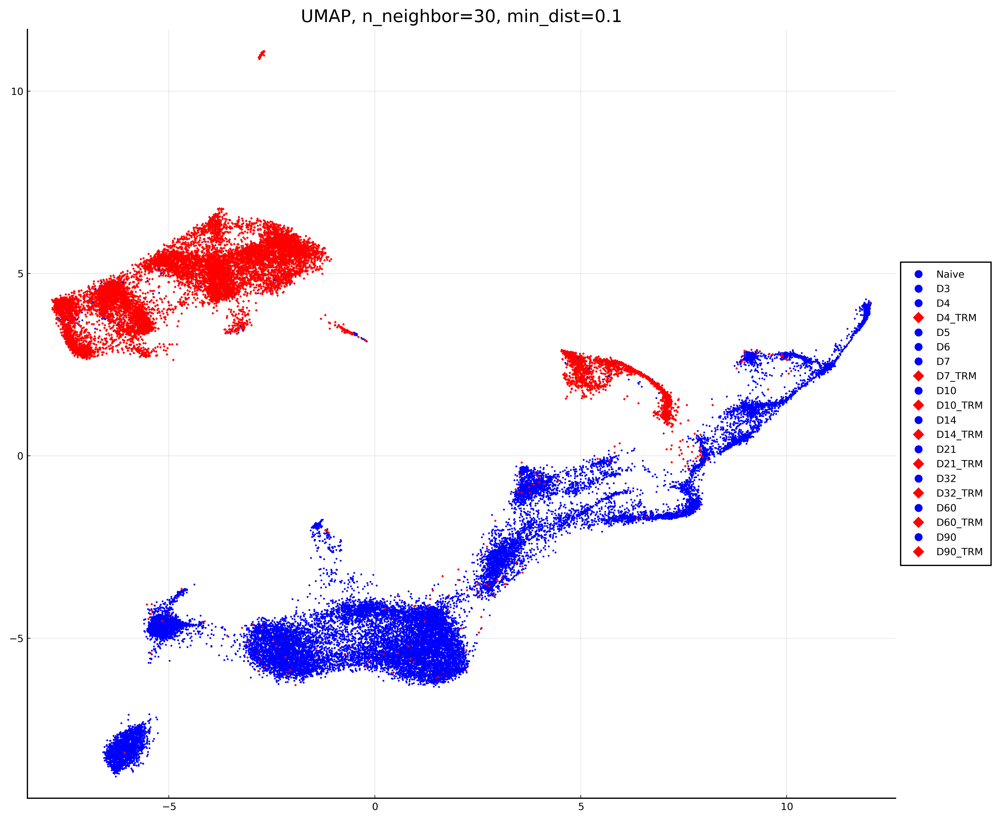

In [77]:
figure = plot(title="UMAP, n_neighbor=$n_neighbors, min_dist=$min_dist", legend=:outerright, size=(1100, 900), dpi=600)
for ct in cell_types
    #merge repliates of samples
    occursin("_2", ct) && continue
    index_range = (filtered_cell_label .== ct) .| (filtered_cell_label .== "$(ct)_2")

    scatter!(
        res_jl[1,index_range], 
        res_jl[2,index_range], 
        label=ct, markerstrokewidth=0, markersize=1.5,
        marker=occursin("TRM", ct) ? :diamond : :circle,
        markercolor=occursin("TRM", ct) ? :red : :blue
    )
end
savefig("all_umap_trm_vs_spleen.pdf")

### Focus Group Analysis

In [79]:
trm_foci_cell_type = [ct for ct in cell_types if occursin("TRM", ct)]

9-element Array{String,1}:
 "D4_TRM"
 "D7_TRM"
 "D10_TRM"
 "D14_TRM"
 "D21_TRM"
 "D32_TRM"
 "D32_TRM_2"
 "D60_TRM"
 "D90_TRM"

In [80]:
#barcode
open("barcodes.tsv", "w") do write_barcode
    for (bc, ct) in zip(raw_umi_cnt["cell_id"], cell_type_label)
        ct ∉ trm_foci_cell_type && continue
        write(write_barcode, "$bc-$ct\n")
    end
end

#gene names
open("genes.tsv", "w") do write_genes
    for (i, gn) in enumerate(names(raw_umi_cnt)[2:end])
        write(write_genes, "fakename$i\t$gn")
        write(write_genes, "\n")
    end
end

#matrix
open("matrix.mtx", "w") do write_matrix
    write(write_matrix, "%%MatrixMarket matrix coordinate real general\n%\n")
    
    focus_index = [ct ∈ trm_foci_cell_type for ct in cell_type_label]
    
    #gene - cell mtx
    mat = Matrix(raw_umi_cnt[focus_index, 2:end])' |> copy
    n, m = size(mat)
    
    I, J, V = Int[], Int[], Int[]
    nzvals = 0
    
    for j = 1:m, i = n:-1:1
        v = mat[i, j]
        if v != 0
            nzvals += 1
            push!(I, i)
            push!(J, j)
            push!(V, v)
        end
    end
    
    write(write_matrix, "$n\t$m\t$nzvals\n")
    for i = 1:nzvals
        write(write_matrix, "$(I[i])\t$(J[i])\t$(V[i])\t")
    end
end

In [84]:
trm_only_hvgs = seurat_extrat_hvg_list("trm_only_sc")

┌ Warning: RCall.jl: Warning: Feature names cannot have underscores ('_'), replacing with dashes ('-')
└ @ RCall /home/coco/.julia/packages/RCall/Qzssx/src/io.jl:160
┌ Warning: RCall.jl: Performing log-normalization
│ 0%   10   20   30   40   50   60   70   80   90   100%
│ [----|----|----|----|----|----|----|----|----|----|
│ **************************************************|
└ @ RCall /home/coco/.julia/packages/RCall/Qzssx/src/io.jl:160
┌ Warning: RCall.jl: Calculating gene variances
│ 0%   10   20   30   40   50   60   70   80   90   100%
│ [----|----|----|----|----|----|----|----|----|----|
│ **************************************************|
│ Calculating feature variances of standardized and clipped values
│ 0%   10   20   30   40   50   60   70   80   90   100%
│ [----|----|----|----|----|----|----|----|----|----|
│ **************************************************|
└ @ RCall /home/coco/.julia/packages/RCall/Qzssx/src/io.jl:160


3000-element Array{String,1}:
 "Cd74"
 "Hist1h2ap"
 "Mt1"
 "Ube2c"
 "Tyrobp"
 "Mt2"
 "Fcer1g"
 "Pclaf"
 "Dapl1"
 "Gzma"
 "Lgals1"
 "Ifitm1"
 "Birc5"
 ⋮
 "Sap18b"
 "Tsen54"
 "Gan"
 "Adipor2"
 "Slc24a5"
 "Skp1a"
 "Stk11ip"
 "Zbtb41"
 "Gstz1"
 "Ccdc90b"
 "Gemin8"
 "Helb"

In [106]:
#work with the data matrix. However keep track of the row and col names before and after filter
focus_index = [ct ∈ trm_foci_cell_type for ct in cell_type_label]
raw_umi_mat = raw_umi_cnt[focus_index, 2:end]|> Matrix

15318×9941 Array{Int64,2}:
 0  1  0  0  0  0  0  0  0  0  0  0  0  …   0  0   1  0  0    2  0  0  0  1
 2  1  1  0  0  0  0  0  0  1  2  1  0     21  5  99  7  0  143  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  0      3  1  22  0  0   57  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  0      2  1   8  0  0   16  0  0  0  0
 0  0  0  1  0  0  0  0  0  0  1  0  0      1  0   7  4  0   11  0  0  0  0
 1  0  0  0  1  0  0  1  0  0  0  0  0  …   8  3  32  0  1   57  0  0  0  1
 0  0  0  0  0  0  0  0  0  0  0  0  0      0  1   6  2  0   12  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  1  0      4  0  13  0  0   28  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  1  1      4  1  16  2  0   46  0  0  1  0
 1  1  0  0  1  0  0  0  0  0  0  0  2      6  4  27  2  0   57  0  0  0  0
 0  0  0  0  0  0  0  0  0  0  0  0  0  …   2  1   3  1  0   26  0  0  0  0
 0  0  0  0  1  0  0  0  0  0  0  0  0      0  0   1  0  0    3  0  0  0  0
 3  0  4  0  1  0  0  1  1  0  1  2  0      7  2  18  4  0   

In [107]:
umi_norm_mat, cell_filter, gene_filter = filter_norm_data(raw_umi_mat)

14663 cells and 9933 genes pass filter


([0.0 0.0 … 0.0 0.0; 2.139342508735649 0.0 … 0.0 0.0; … ; 0.0 3.254149040026033 … 3.254149040026033 0.0; 0.0 0.0 … 5.694760820045558 0.0], Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1], Bool[1, 1, 1, 1, 1, 1, 1, 1, 1, 1  …  1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [100]:
filtered_cell_label = cell_type_label[focus_index][cell_filter]
filtered_genes = names(raw_umi_cnt)[2:end][gene_filter]

9933-element Array{String,1}:
 "Mrpl15"
 "Lypla1"
 "Tcea1"
 "Atp6v1h"
 "Rb1cc1"
 "X4732440D04Rik"
 "Pcmtd1"
 "Rrs1"
 "Vcpip1"
 "Sgk3"
 "Snhg6"
 "Cops5"
 "Cspp1"
 ⋮
 "mt.Atp6"
 "mt.Co3"
 "mt.Nd3"
 "mt.Nd4l"
 "mt.Nd4"
 "mt.Nd5"
 "mt.Nd6"
 "mt.Cytb"
 "Vamp7"
 "AC125149.3"
 "AC149090.1"
 "CAAA01118383.1"

In [108]:
umi_norm_log_mat = log.(umi_norm_mat .+ 1)

14663×9933 Array{Float64,2}:
 0.0       0.0       0.0       0.0       …  0.0       0.0       0.0
 1.14401   0.0       1.34871   0.0          0.0       0.0       0.0
 0.0       0.64105   0.0       0.0          0.0       0.0       0.0
 0.841024  0.0       0.841024  0.0          0.0       0.0       0.0
 0.526928  0.0       0.870223  0.0          0.0       0.0       0.0
 0.948672  0.667505  0.667505  0.274943  …  0.0       0.0       0.274943
 1.17053   0.909254  0.554595  0.0          0.0       0.0       0.0
 0.884706  0.537158  0.537158  0.0          0.537158  0.0       0.537158
 0.690855  0.0       0.0       0.403938     0.0       0.0       0.403938
 0.979347  0.809613  0.605058  0.605058     0.0       0.0       0.34761
 0.717346  0.421662  0.421662  0.421662  …  0.0       0.0       0.717346
 0.0       0.940507  0.0       0.940507     0.0       0.0       0.0
 1.44458   1.15059   0.0       0.732382     0.0       0.0       0.0
 ⋮                                       ⋱  ⋮                  

Keep HVGs

In [110]:
#High Variable genes
hvg_index = [i for (i, gn) in enumerate(filtered_genes) if gn ∈ trm_only_hvgs]

hvg_umi_norm_mat = umi_norm_log_mat[:, hvg_index]
hvg_umi_norm_zmat = standardize(ZScoreTransform, hvg_umi_norm_mat, dims = 1)

14663×2997 Array{Float64,2}:
 -0.62372   -0.334126  -0.604489  …  -0.776577    0.728233  -0.369865
  1.3723     1.16798    0.3261        1.08497     0.835581  -0.369865
 -0.62372   -0.334126  -0.604489      0.340574    0.859257  -0.369865
  0.843658  -0.334126  -0.604489     -0.395937   -0.37286   -0.369865
  0.29564   -0.334126   1.69188      -0.942189    0.448429  -0.369865
  1.03148    0.433072  -0.129191  …   0.328252    0.891218   0.339621
  1.41857   -0.334126   1.41903       0.302555    0.85235   -0.369865
  0.919874  -0.334126   0.324103      0.168291    0.740039   1.01626
  0.581651   0.793017   0.589802      0.0474983   0.129667   0.672489
  1.085      1.92501   -0.604489     -1.21135    -0.150285   0.527136
  0.627871  -0.334126  -0.604489  …  -0.319623    0.77087    1.48123
 -0.62372   -0.334126  -0.604489      0.562946    1.22764   -0.369865
  1.89672    1.70951    0.661591      0.90379     1.26135   -0.369865
  ⋮                               ⋱               ⋮         
 -

UMAP

In [111]:
M = fit(PCA, hvg_umi_norm_zmat'; maxoutdim=50)

PCA(indim = 2997, outdim = 50, principalratio = 0.11337393093594057)

In [123]:
principalvars(M)

50-element Array{Float64,1}:
 156.07123815923816
  26.38496577196158
  14.49998281218707
   9.618029433032254
   8.048688694321587
   7.277124286737907
   6.188802790796314
   5.968191692168974
   4.9272006407391755
   4.6749208367060096
   4.4037189230731135
   3.8933567571401357
   3.8241957001199274
   ⋮
   1.9972235688107998
   1.9916116516470503
   1.98556201491339
   1.978797413352189
   1.9753280298014766
   1.9702936469359034
   1.964789988904052
   1.961686690238725
   1.955928854052826
   1.950411642265402
   1.9481399994008126
   1.946070707362625

In [112]:
hvg_umi_pca_transform = MultivariateStats.transform(M, hvg_umi_norm_zmat');

In [201]:
pc_dims, n_neighbors, min_dist = 25, 20, 0.05
res_jl = umap(hvg_umi_pca_transform[1:pc_dims, :]; n_neighbors=n_neighbors, min_dist=min_dist, metric=Jaccard(), n_epochs=200)

2×14663 Array{Float64,2}:
 -4.69187  10.4782   7.97698   10.6332   …  -2.5618   -2.97891  -2.47467
 -3.13053  -1.26183  0.326569  -2.16701     -8.04101  -7.16353  -6.45292

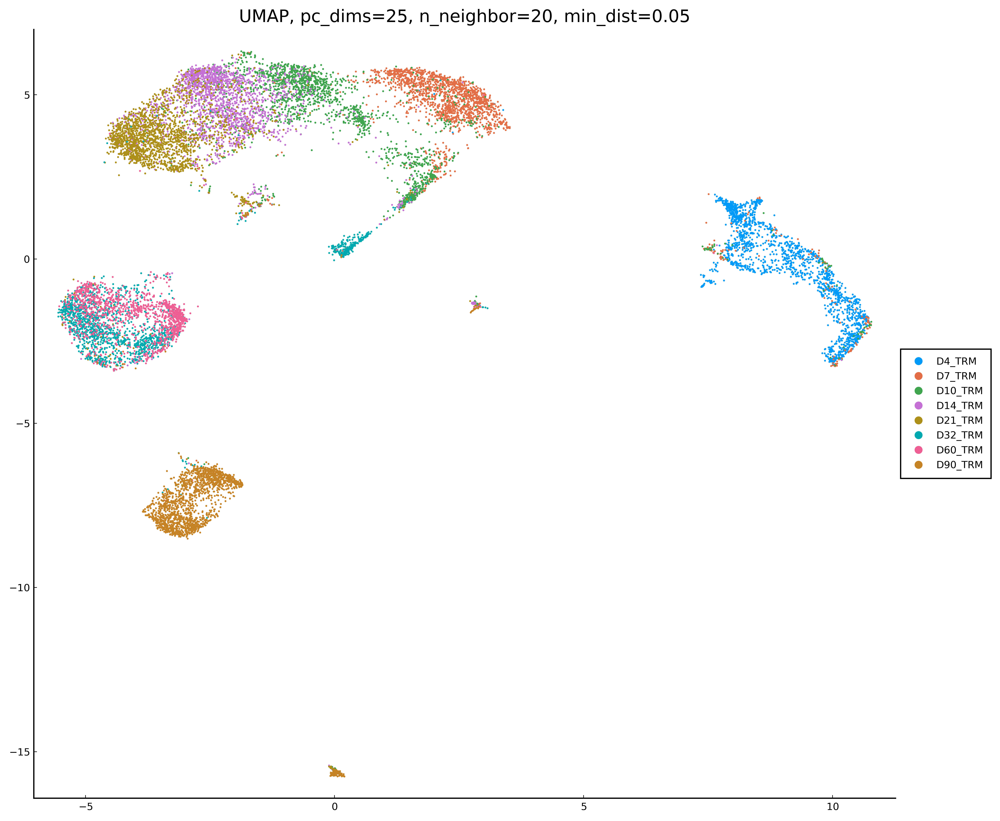

In [203]:
figure = plot(grid=:off, title="UMAP, pc_dims=$pc_dims, n_neighbor=$n_neighbors, min_dist=$min_dist", legend=:outerright, size=(1100, 900), dpi=600)
for ct in unique(filtered_cell_label)
    #merge repliates of samples
    occursin("_2", ct) && continue
    index_range = (filtered_cell_label .== ct) .| (filtered_cell_label .== "$(ct)_2")

    scatter!(
        res_jl[1,index_range], 
        res_jl[2,index_range], 
        label=ct, markerstrokewidth=0, 
        markersize=1.5, #color=rand(1:256, 3),
        #marker=occursin("TRM", ct) ? :diamond : :circle,
        #ylims=(-7, 13),
    )
end
figure
savefig("trm_only_umap_complete_cell_type_position_reference.pdf")

In [191]:
focus_genes = ["Icos", "Zeb2", "Bcl6", "Id3", "Prdm1"]
trm_only_focus_genes_magic_exp = magic_impute_expression(umi_norm_mat, focus_genes)

Calculating MAGIC...
  Running MAGIC on 14663 cells and 9933 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 31.22 seconds.
    Calculating KNN search...
    Calculated KNN search in 23.17 seconds.
    Calculating affinities...
    Calculated affinities in 22.73 seconds.
  Calculated graph and diffusion operator in 115.50 seconds.
  Calculating imputation...
Calculated MAGIC in 172.27 seconds.


14663×5 Array{Float64,2}:
 0.212811   0.0601088    0.0226027    0.0796071   0.0573154
 1.16855    0.00275054   0.00123851   0.0113917   0.0243205
 1.18916    0.000359928  0.000344481  0.00193443  0.0131493
 1.70562    0.00278834   0.000557116  0.00318368  0.0191799
 1.14137    0.00119363   7.18608e-5   0.00260031  0.0186099
 1.32772    0.0040258    0.000229428  0.00341988  0.0559094
 1.15886    0.00130504   0.000144402  0.00616988  0.0197472
 1.14406    0.00153397   0.000144581  0.00556505  0.0178401
 1.3517     0.00706412   0.00180423   0.0119387   0.0409833
 0.988927   0.00121526   1.06595e-5   0.00443404  0.0433981
 1.04123    0.00155427   2.62169e-5   0.00190809  0.02446
 1.66401    0.000248899  3.98997e-5   0.00181914  0.00542586
 0.894624   0.000409467  0.000262129  0.0030784   0.0144158
 ⋮                                                
 0.0315895  0.0132191    0.00115065   0.058927    0.0380565
 0.364741   0.133289     0.00192689   0.145368    0.0115153
 0.119803   0.0874697   

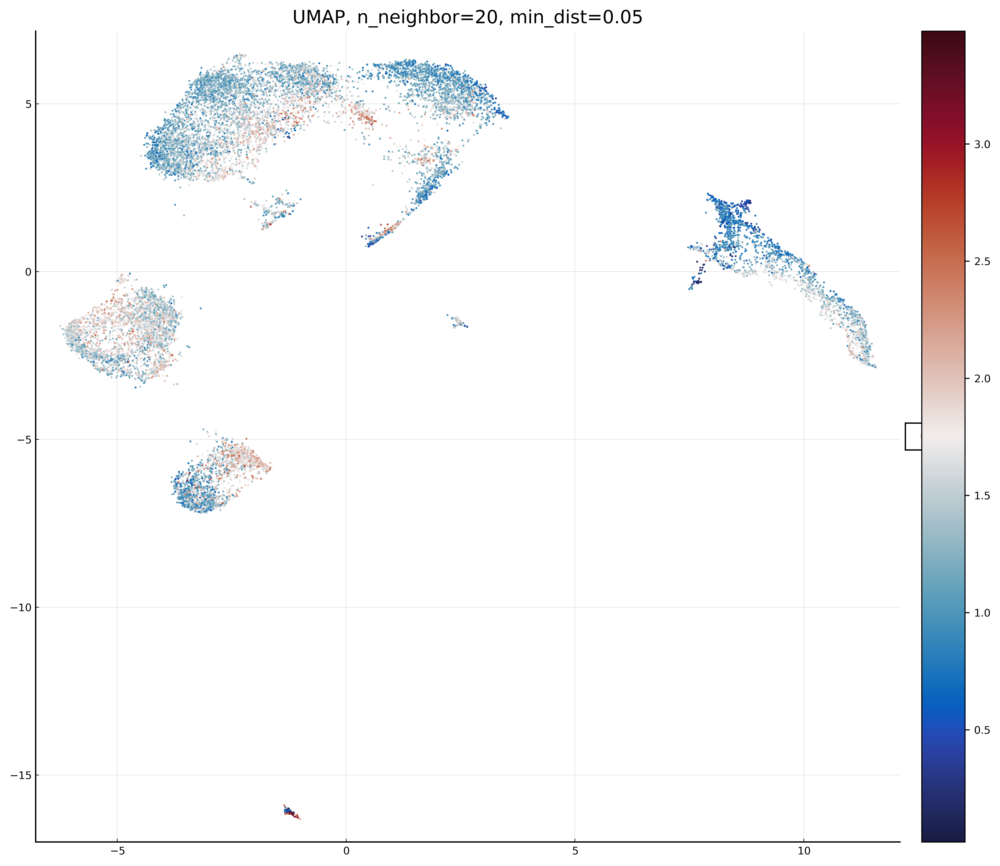

In [196]:
for (i, gene) in enumerate(focus_genes)
    gx = log.(vec(trm_only_focus_genes_magic_exp[:,i]) * 100 .+ 1)
    figure = plot(title="UMAP, pc_dim=$pc_dims, n_neighbor=$n_neighbors, min_dist=$min_dist", legend=:outerright, size=(1100, 900), dpi=600)
    scatter!(
        res_jl[1,:], 
        res_jl[2,:], 
        markerstrokewidth=0, markersize=1.5, 
        zcolor=gx, mc=:balance,
        #marker=occursin("TRM", ct) ? :diamond : :circle,
        #zlims = [0,max],
    )
    savefig("trm_only_umap_$(gene)_z.pdf")
end

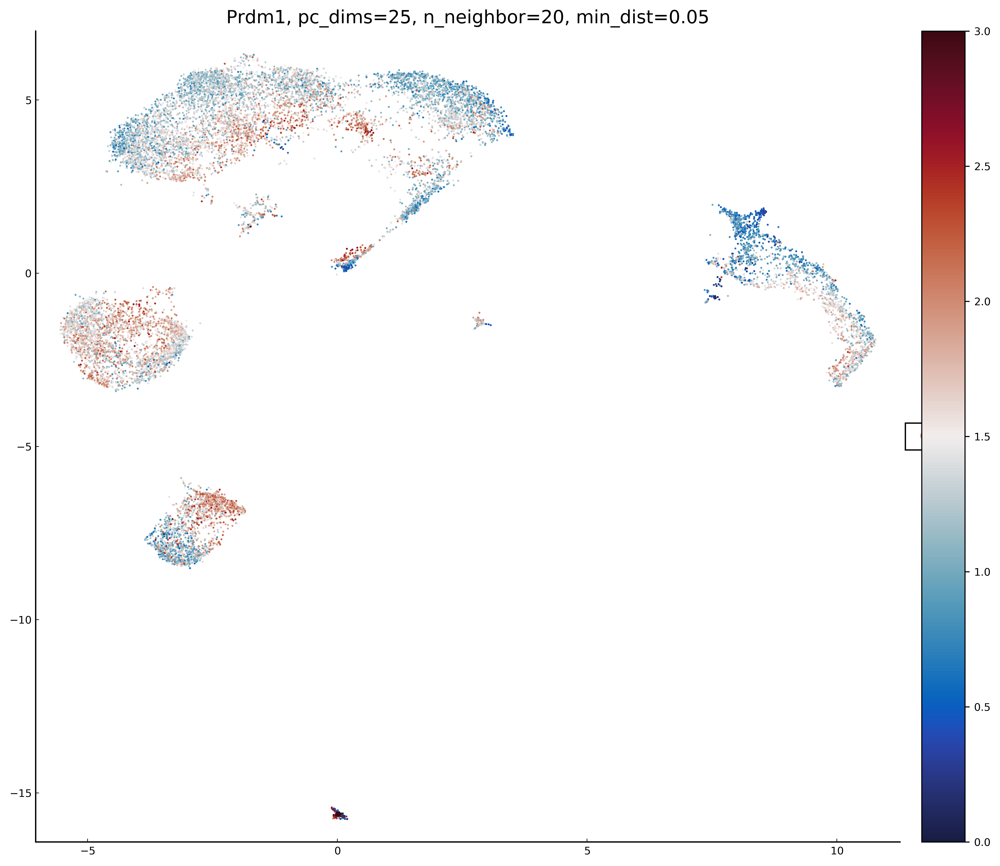

In [221]:
i = 5
gene = focus_genes[i]
gx = log.(vec(trm_only_focus_genes_magic_exp[:,i]) * 100 .+ 1)
figure = plot(grid=:off, title="$gene, pc_dims=$pc_dims, n_neighbor=$n_neighbors, min_dist=$min_dist", legend=:outerright, size=(1100, 900), dpi=600)
scatter!(
    res_jl[1,:], 
    res_jl[2,:], 
    markerstrokewidth=0, markersize=1.5, 
    zcolor=gx, mc=:balance,
    #marker=occursin("TRM", ct) ? :diamond : :circle,
    clim = (0,3),
)
savefig("trm_only_umap_$(gene)_z.pdf")

### Violin Plot Figure

In [229]:
"Tnfrsf9" ∈ names(raw_umi_cnt)

true

In [247]:
target_gene = "Tnfrsf18"

"Tnfrsf18"

Calculating MAGIC...
  Running MAGIC on 1950 cells and 9219 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 2.88 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.44 seconds.
    Calculating affinities...
    Calculated affinities in 0.44 seconds.
  Calculated graph and diffusion operator in 4.24 seconds.
  Calculating imputation...
Calculated MAGIC in 5.09 seconds.
Calculating MAGIC...
  Running MAGIC on 1978 cells and 9897 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 3.19 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.41 seconds.
    Calculating affinities...
    Calculated affinities in 0.40 seconds.
  Calculated graph and diffusion operator in 4.57 seconds.
  Calculating imputation...
Calculated MAGIC in 5.52 seconds.
Calculating MAGIC...
  Running MAGIC on 1479 cells and 9901 genes.
  Calculating graph and diffusion operator...
    Calcu

/home/coco/miniconda3/lib/python3.7/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  if isinstance(target_data, pd.SparseDataFrame):
/home/coco/miniconda3/lib/python3.7/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  if isinstance(target_data, pd.SparseDataFrame):
/home/coco/miniconda3/lib/python3.7/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  if isinstance(target_data, pd.SparseDataFrame):
/home/coco/miniconda3/lib/python3.7/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be remove

Calculating MAGIC...
  Running MAGIC on 1980 cells and 9650 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 2.63 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.46 seconds.
    Calculating affinities...
    Calculated affinities in 0.45 seconds.
  Calculated graph and diffusion operator in 3.88 seconds.
  Calculating imputation...
Calculated MAGIC in 4.58 seconds.
Calculating MAGIC...
  Running MAGIC on 1836 cells and 9498 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 2.43 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.39 seconds.
    Calculating affinities...
    Calculated affinities in 0.38 seconds.
  Calculated graph and diffusion operator in 3.51 seconds.
  Calculating imputation...
Calculated MAGIC in 4.14 seconds.
Calculating MAGIC...
  Running MAGIC on 1318 cells and 9411 genes.
  Calculating graph and diffusion operator...
    Calcu

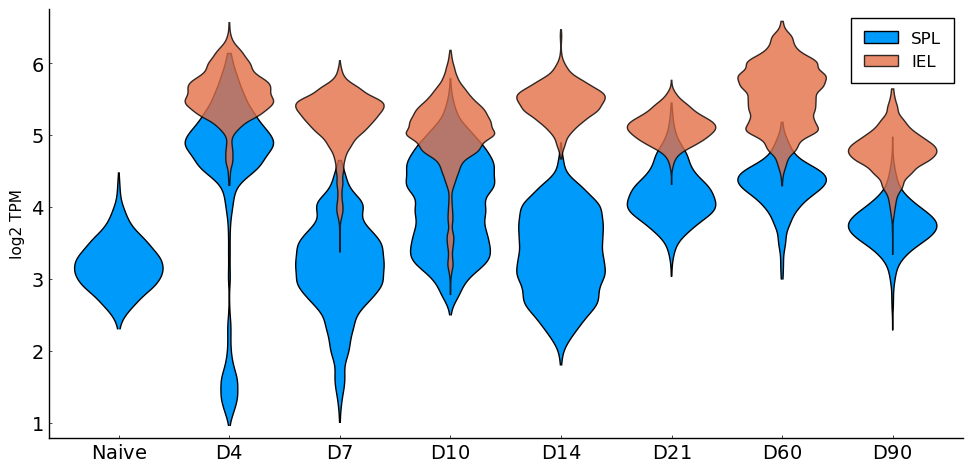

In [248]:
norm_to, min_tot, min_cell = 1_000_000, 1_000, 5
target_exp = Dict{String,Vector}() #sample => (cell1, cell2, ..., celln) Icos expression
#data_dir = "data/GSE131847_RAW"
for umi_table in readdir(data_dir)
    name = match(r"GSM\d*_(.*)_cell-gene", umi_table)[1]
    ct_tbl = CSV.read(joinpath(data_dir, umi_table), DataFrame)
    genes = names(ct_tbl)[2:end]
    #normalization
    ctm = Matrix(ct_tbl[:,2:end])
    cell_sum_umi = vec(sum(ctm, dims = 2))
    size_factor = norm_to ./ cell_sum_umi
    min_tot_filter = cell_sum_umi .>= min_tot
    ctm_normed_sqrt = sqrt.(Diagonal(size_factor) * ctm)
    #magic impute
    py_ctm = pandas.DataFrame(
        Dict(
            genes[i] => ge[min_tot_filter] for (i, ge) in enumerate(eachcol(ctm_normed_sqrt)) if sum(ge[min_tot_filter] .!= 0) > min_cell
        )
    )
    magic_op = magic.MAGIC()
    py_ctm_magic = magic_op.fit_transform(py_ctm, genes = [target_gene])
    target_exp[name] = [v^2 for v in py_ctm_magic[target_gene]]
    #icos_col = findfirst(names(ct_tbl) .== "Icos") - 1
    #ctm_normed_sqrt[:, icos_col]
end

#icos_exp["D6"]

spl_samples = ["Naive", "D3", "D4", "D5", "D6", "D7", "D10", "D14", "D21", "D32", "D60", "D90"]
trm_samples = ["D4_TRM", "D7_TRM", "D10_TRM", "D14_TRM", "D21_TRM", "D32_TRM", "D60_TRM", "D90_TRM"]
trm_sample_pos = [3,6,7,8,9,10,11,12]


exclude = ["D3", "D5", "D6", "D32", "D32_TRM"]
spl_shrink_samples = [x for x in spl_samples if x ∉ exclude]
trm_samples = ["D4_TRM", "D7_TRM", "D10_TRM", "D14_TRM", "D21_TRM", "D60_TRM", "D90_TRM"]

for smp in spl_samples
    println(smp, "\t", mean(target_exp[smp]))
end

for smp in trm_samples
    println(smp, "\t", mean(target_exp[smp]))
end

target_spl_expr = []
target_spl_label = []
for (i, smp) in enumerate(spl_shrink_samples)
    n = length(target_exp[smp])
    append!(target_spl_expr, log2.(target_exp[smp] .+ 1))
    append!(target_spl_label, repeat([i], n))
end

spl_target_exp = DataFrame(:Target_Expr => target_spl_expr, :Sample => target_spl_label)

target_trm_expr = []
target_trm_label = []
for (i, smp) in zip(2:length(spl_shrink_samples), trm_samples)
    global exclude
    smp ∈ exclude && continue
    n = length(target_exp[smp])
    append!(target_trm_expr, log2.(target_exp[smp] .+ 1))
    append!(target_trm_label, repeat([i], n))
end
trm_target_exp = DataFrame(:Target_Expr => target_trm_expr, :Sample => target_trm_label)

plot(grid = false, ylabel = "log2 TPM", margin = 6mm, size = (1000,500), xtickfontsize=14, ytickfontsize=14, legendfontsize=12)
@df spl_target_exp violin!(:Sample, :Target_Expr, xticks = (1:length(spl_shrink_samples), spl_shrink_samples), label = "SPL")
@df trm_target_exp violin!(:Sample, :Target_Expr, alpha = 0.8, label = "IEL")
savefig("$(target_gene)_tc_expr.scRNA_SciImmu.pdf")

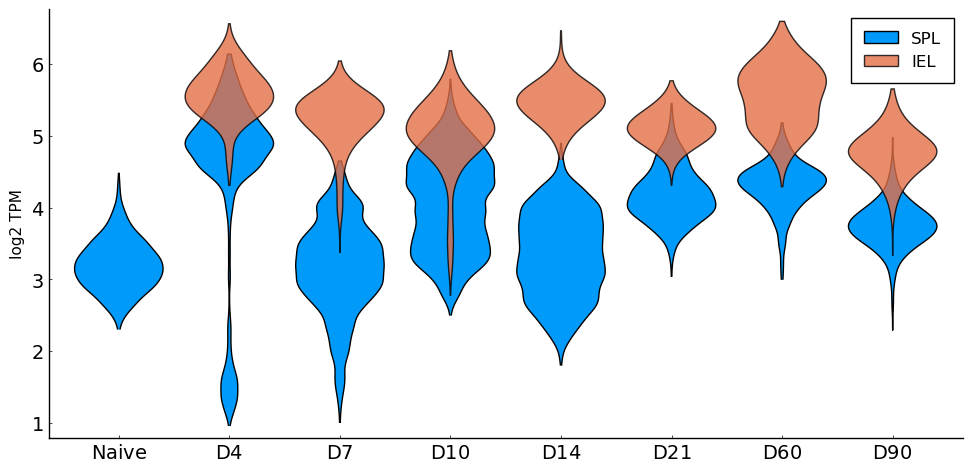

In [250]:
plot(grid = false, ylabel = "log2 TPM", margin = 6mm, size = (1000,500), xtickfontsize=14, ytickfontsize=14, legendfontsize=12)
@df spl_target_exp violin!(:Sample, :Target_Expr, xticks = (1:length(spl_shrink_samples), spl_shrink_samples), label = "SPL")
@df trm_target_exp violin!(:Sample, :Target_Expr, alpha = 0.8, label = "IEL", bandwidth= 0.15)
savefig("$(target_gene)_tc_expr.scRNA_SciImmu.pdf")